In [1]:
import pandas as pd
df=pd.read_csv('data.csv')

In [8]:
df['ncp'].describe()

count    353681.000000
mean          8.941400
std          26.126027
min       -4520.955300
25%           2.588476
50%           5.744382
75%          10.906652
max        1470.575900
Name: ncp, dtype: float64

In [ ]:
# extremly skewed , how to deal with this /


   crsID  Count
0     18     66
1     29      8
2     32      2
3     20      1
4     38      1


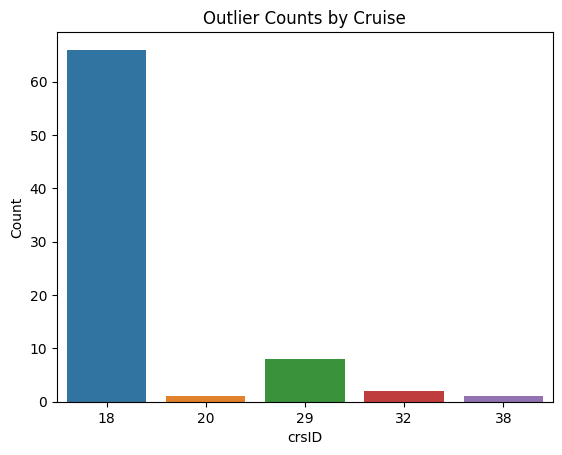

/tmp/ipykernel_810623/2540710258.py:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  outliers['Date'] = outliers['Yr'].astype(str) + '-' + outliers['Mn'].astype(str) + '-' + outliers['Dy'].astype(str)


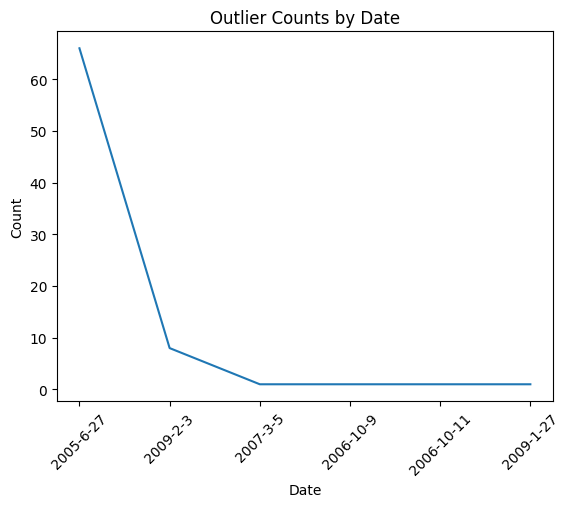

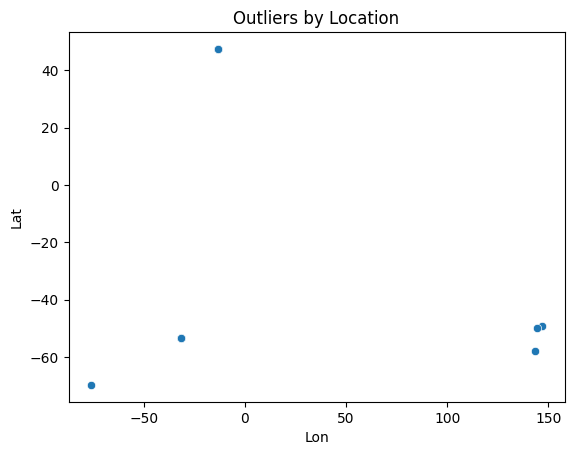

In [12]:
import seaborn as sns
import pandas as pd


mean = df['ncp'].mean()
std_dev = df['ncp'].std()
df['Outlier'] = (df['ncp'] < mean - 8*std_dev) | (df['ncp'] > mean + 8*std_dev)


outliers = df[df['Outlier']]


cruise_counts = outliers['crsID'].value_counts().reset_index()
cruise_counts.columns = ['crsID', 'Count']
print(cruise_counts)


sns.barplot(x='crsID', y='Count', data=cruise_counts)
plt.title('Outlier Counts by Cruise')
plt.show()


outliers['Date'] = outliers['Yr'].astype(str) + '-' + outliers['Mn'].astype(str) + '-' + outliers['Dy'].astype(str)
date_counts = outliers['Date'].value_counts().reset_index()
date_counts.columns = ['Date', 'Count']

sns.lineplot(x='Date', y='Count', data=date_counts)
plt.title('Outlier Counts by Date')
plt.xticks(rotation=45)
plt.show()


sns.scatterplot(x='Lon', y='Lat', data=outliers)
plt.title('Outliers by Location')
plt.show()


In [14]:
df_32=df[df['crsID'] == 32]

In [16]:
df_32.describe()

,Unnamed: 0,iso,crsID,Lat,Lon,Yr,Mn,Dy,salt,temp,...,PIC,POC,aot,Rrs_412,Rrs_443,Rrs_490,Rrs_510,Rrs_555,Rrs_670,ID
count,15.000000,15.000000,15.0,15.000000,15.000000,15.0,15.000000,15.000000,15.000000,15.000000,...,15.000000,15.000000,15.000000,15.000000,15.000000,15.000000,15.000000,15.000000,15.000000,15.000000
mean,350157.000000,732621.233750,32.0,-53.087270,145.172018,2006.0,9.733333,13.800000,34.111213,3.871800,...,0.000211,52.465462,0.100787,0.007132,0.006610,0.005311,0.003551,0.001790,0.000306,667677.400000
std,4.472136,8.047264,0.0,4.460463,1.608397,0.0,0.457738,5.833401,0.338359,3.831583,...,0.000119,6.187415,0.053926,0.001455,0.001325,0.000929,0.000817,0.000412,0.000177,14.161316
min,350150.000000,732607.040278,32.0,-60.382913,142.290238,2006.0,9.000000,9.000000,33.819700,-0.405500,...,0.000050,45.066570,0.025500,0.005210,0.004660,0.003940,0.002540,0.001160,0.000020,667659.000000
25%,350153.500000,732616.960417,32.0,-55.758665,144.125581,2006.0,9.500000,10.000000,33.864900,0.913700,...,0.000135,46.949900,0.055620,0.006230,0.005880,0.004730,0.003040,0.001565,0.000215,667665.500000
50%,350157.000000,732625.215278,32.0,-53.730538,144.841485,2006.0,10.000000,11.000000,33.905900,2.178600,...,0.000180,50.949909,0.097600,0.006960,0.006500,0.005330,0.003510,0.001740,0.000270,667673.000000
75%,350160.500000,732626.210764,32.0,-48.555692,146.962309,2006.0,10.000000,17.000000,34.528000,8.512850,...,0.000260,56.199905,0.139785,0.007595,0.006990,0.005605,0.003720,0.001955,0.000395,667690.500000
max,350164.000000,732627.549306,32.0,-46.815167,147.292167,2006.0,10.000000,24.000000,34.644800,9.229100,...,0.000550,66.199913,0.209600,0.010860,0.010090,0.007700,0.005790,0.002900,0.000760,667698.000000


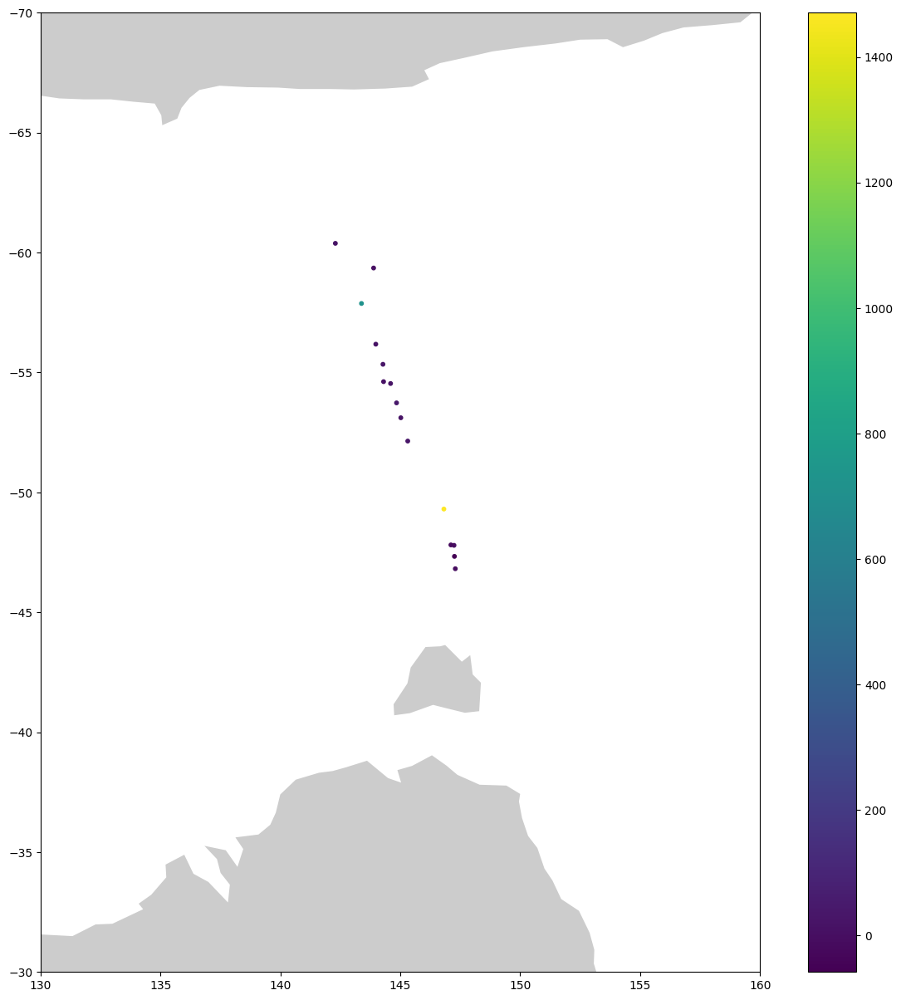

In [17]:
import geopandas as gpd
import matplotlib.pyplot as plt
from shapely.geometry import Point

world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
geometry = [Point(xy) for xy in zip(df_32['Lon'], df_32['Lat'])]
geo_df = gpd.GeoDataFrame(df_32, geometry=geometry)

# Define the limits of your map
x_min, x_max = 130, 160 # replace these with your desired longitude range
y_min, y_max = -30, -70 # replace these with your desired latitude range

# Plot the data
fig, ax = plt.subplots(figsize=(15,15))
world.plot(ax=ax, alpha=0.4, color='grey')
geo_df.plot(column='ncp', ax=ax, legend=True, markersize=10)

# Set the limits
ax.set_xlim(x_min, x_max)
ax.set_ylim(y_min, y_max)

plt.show()


In [3]:
df_20=df[df['crsID'] == 20]
df_20.describe()

,Unnamed: 0,iso,crsID,Lat,Lon,Yr,Mn,Dy,salt,temp,...,PIC,POC,aot,Rrs_412,Rrs_443,Rrs_490,Rrs_510,Rrs_555,Rrs_670,ID
count,32.000000,32.000000,32.0,32.000000,32.000000,32.0,32.00000,32.000000,32.000000,32.000000,...,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000,32.000000
mean,323214.500000,732738.021712,20.0,-58.882990,-60.323089,2007.0,2.56250,14.312500,33.869062,3.739375,...,0.000462,82.673935,0.032767,0.006932,0.006197,0.005274,0.003889,0.002288,0.000375,598878.843750
std,9.380832,22.410045,0.0,8.398969,10.010029,0.0,0.75935,5.704766,0.594308,5.176611,...,0.000363,46.601583,0.021357,0.002227,0.001906,0.001434,0.000793,0.000667,0.000206,31.783653
min,323199.000000,732718.810417,20.0,-71.240670,-83.766500,2007.0,2.00000,1.000000,32.620000,-1.220000,...,0.000060,27.949900,0.006140,0.002940,0.002630,0.002370,0.002410,0.001130,0.000090,598846.000000
25%,323206.750000,732721.764499,20.0,-63.532583,-63.890295,2007.0,2.00000,12.000000,33.597500,-0.742500,...,0.000210,55.937069,0.017865,0.005658,0.005085,0.004320,0.003393,0.001795,0.000230,598857.750000
50%,323214.500000,732724.383333,20.0,-59.921420,-54.732500,2007.0,2.00000,14.000000,33.870000,2.705000,...,0.000305,66.342682,0.026775,0.006900,0.006210,0.005475,0.003720,0.002060,0.000320,598866.000000
75%,323222.250000,732749.049994,20.0,-54.035542,-53.000000,2007.0,3.00000,16.000000,34.015000,6.440000,...,0.000555,90.249910,0.043588,0.008330,0.007515,0.006320,0.004513,0.002768,0.000475,598890.500000
max,323230.000000,732781.672800,20.0,-39.423330,-51.159500,2007.0,4.00000,29.000000,35.850000,18.460000,...,0.001450,254.565979,0.106020,0.013290,0.011260,0.008280,0.005560,0.003730,0.000880,598946.000000


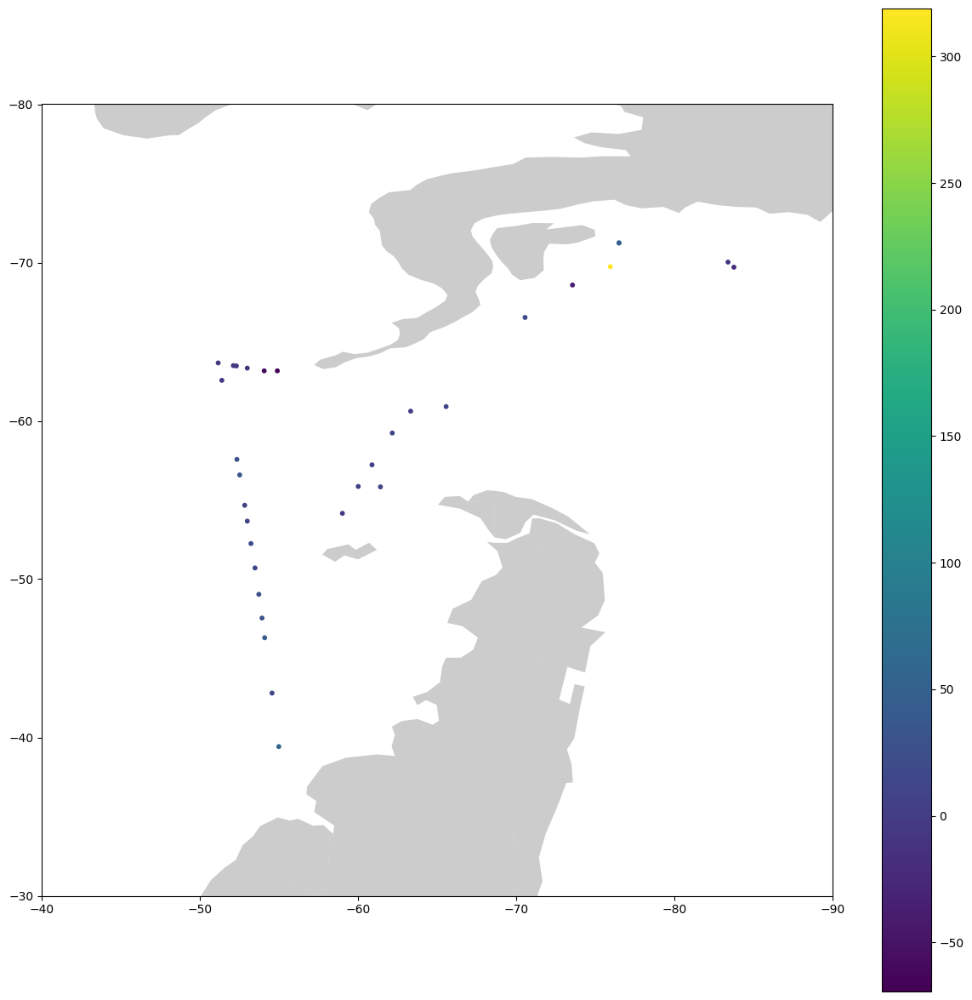

In [5]:
import geopandas as gpd
import matplotlib.pyplot as plt
from shapely.geometry import Point

world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
geometry = [Point(xy) for xy in zip(df_20['Lon'], df_20['Lat'])]
geo_df = gpd.GeoDataFrame(df_20, geometry=geometry)

# Define the limits of your map
x_min, x_max = -40, -90 # replace these with your desired longitude range
y_min, y_max = -30, -80 # replace these with your desired latitude range

# Plot the data
fig, ax = plt.subplots(figsize=(15,15))
world.plot(ax=ax, alpha=0.4, color='grey')
geo_df.plot(column='ncp', ax=ax, legend=True, markersize=10)

# Set the limits
ax.set_xlim(x_min, x_max)
ax.set_ylim(y_min, y_max)

plt.show()


In [7]:
### define outliers 
mean = df['ncp'].mean()
std_dev = df['ncp'].std()
df['Outlier'] = (df['ncp'] < mean - 10*std_dev) | (df['ncp'] > mean + 10*std_dev)

### drop outliers 

df = df.drop(df[df['Outlier'] == True].index)

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
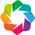

/opt/conda/envs/rapids/lib/python3.10/site-packages/cartopy/io/__init__.py:241: DownloadWarning: Downloading: https://naturalearth.s3.amazonaws.com/110m_physical/ne_110m_ocean.zip
  warnings.warn(f'Downloading: {url}', DownloadWarning)
/opt/conda/envs/rapids/lib/python3.10/site-packages/cartopy/io/__init__.py:241: DownloadWarning: Downloading: https://naturalearth.s3.amazonaws.com/110m_physical/ne_110m_land.zip
  warnings.warn(f'Downloading: {url}', DownloadWarning)


:Overlay
   .Ocean.I  :Feature   [Longitude,Latitude]
   .Land.I   :Feature   [Longitude,Latitude]
   .Points.I :Points   [Longitude,Latitude]   (ncp)

In [10]:
# check the df_2005
df_2005=df[df['Yr'] == 2005]
hv.extension('bokeh')
import pandas as pd
import geoviews as gv
import geoviews.feature as gf
from geoviews import opts
from bokeh.models import HoverTool
import holoviews as hv
from shapely.geometry import Point

# Assuming you have a dataframe called df_2005 with columns 'Lon', 'Lat' and 'ncp'
geometry = [Point(xy) for xy in zip(df_2005['Lon'], df_2005['Lat'])]
geo_df = gpd.GeoDataFrame(df_2005, geometry=geometry)

# Create a gv.Points object
points = gv.Points(geo_df, vdims=['ncp'])

# Specify the hover tool
hover = HoverTool(tooltips=[
    ("index", "$index"),
    ("(x,y)", "($x, $y)"),
    ("ncp", "@ncp"),
])

# Set options for points
points.opts(
    opts.Points(tools=[hover], color='ncp', cmap='viridis', 
                colorbar=True, size=10, global_extent=True, 
                width=800, height=600, title="NCP in 2005")
)

# Combine points with a basemap
gv.output((gf.ocean * gf.land * points).opts(
    opts.RGB(width=600, height=400, active_tools=['wheel_zoom']))
)

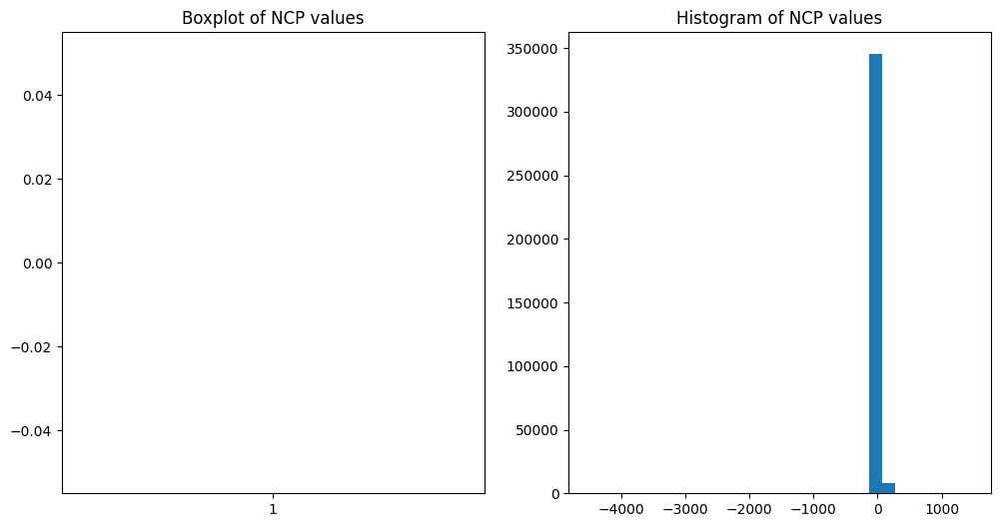

In [3]:
import matplotlib.pyplot as plt

# assuming df is your DataFrame and 'NCP' is your column with NCP values
plt.figure(figsize=(12, 6))

# boxplot
plt.subplot(1, 2, 1)
plt.boxplot(df['ncp'])
plt.title('Boxplot of NCP values')

# histogram
plt.subplot(1, 2, 2)
plt.hist(df['ncp'], bins=30)
plt.title('Histogram of NCP values')

plt.show()

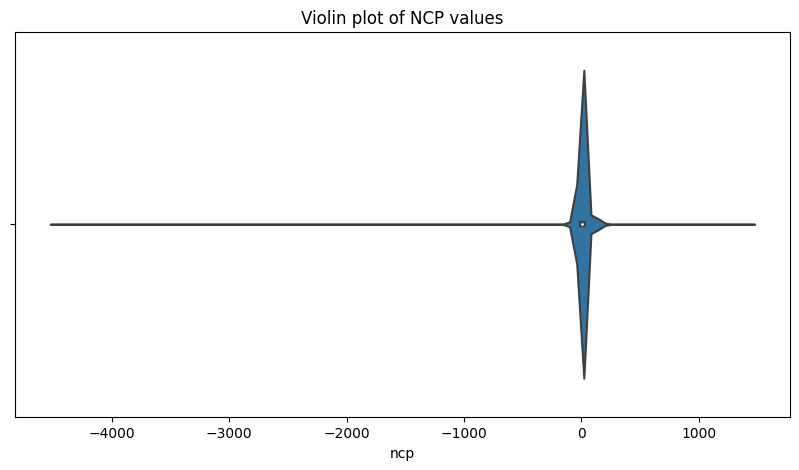

In [5]:
import seaborn as sns

plt.figure(figsize=(10, 5))
sns.violinplot(x=df['ncp'])
plt.title('Violin plot of NCP values')
plt.show()

/opt/conda/envs/rapids/lib/python3.10/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


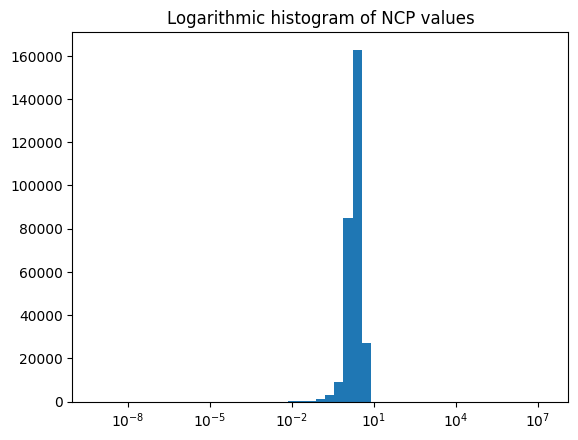

In [7]:
import numpy as np

log_ncp = np.log(df['ncp'] + 0.0001)

plt.hist(log_ncp, bins=np.logspace(np.min(log_ncp), np.max(log_ncp), 50))
plt.gca().set_xscale("log")
plt.title('Logarithmic histogram of NCP values')
plt.show()

In [2]:
# Select features
feature_columns = ['iso', 'crsID', 'Lat', 'Lon', 'Yr', 'Mn', 'Dy', 'salt',
       'temp', 'press', 'neto2', 'Lon70', 'yrmn', 'jd', 'wsi', 'wsj',
       'yd', 'mli', 'mlj', 'CbPM', 'VGPM', 'CDOM', 'CHL', 'KD490',
       'PAR', 'PIC', 'POC', 'aot', 'Rrs_412', 'Rrs_443', 'Rrs_490', 'Rrs_510',
       'Rrs_555', 'Rrs_670']

Epoch 1/10
8842/8842 [==============================] - 64s 7ms/step - loss: 166452768.0000 - val_loss: 12376.3857
Epoch 2/10
8842/8842 [==============================] - 62s 7ms/step - loss: 30312.3594 - val_loss: 98554.2969
Epoch 3/10
8842/8842 [==============================] - 60s 7ms/step - loss: 3524597.7500 - val_loss: 2379.2993
Epoch 4/10
8842/8842 [==============================] - 60s 7ms/step - loss: 26741.2383 - val_loss: 22670.6094
Epoch 5/10
8842/8842 [==============================] - 60s 7ms/step - loss: 34080.2734 - val_loss: 3049.0371
Epoch 6/10
8842/8842 [==============================] - 60s 7ms/step - loss: 16511.5586 - val_loss: 21022.8047
Epoch 7/10
8842/8842 [==============================] - 60s 7ms/step - loss: 15293.0977 - val_loss: 10563.7881
Epoch 8/10
8842/8842 [==============================] - 62s 7ms/step - loss: 14564.3086 - val_loss: 5929178.0000
Epoch 9/10
8842/8842 [==============================] - 61s 7ms/step - loss: 13895.4492 - val_loss: 547746

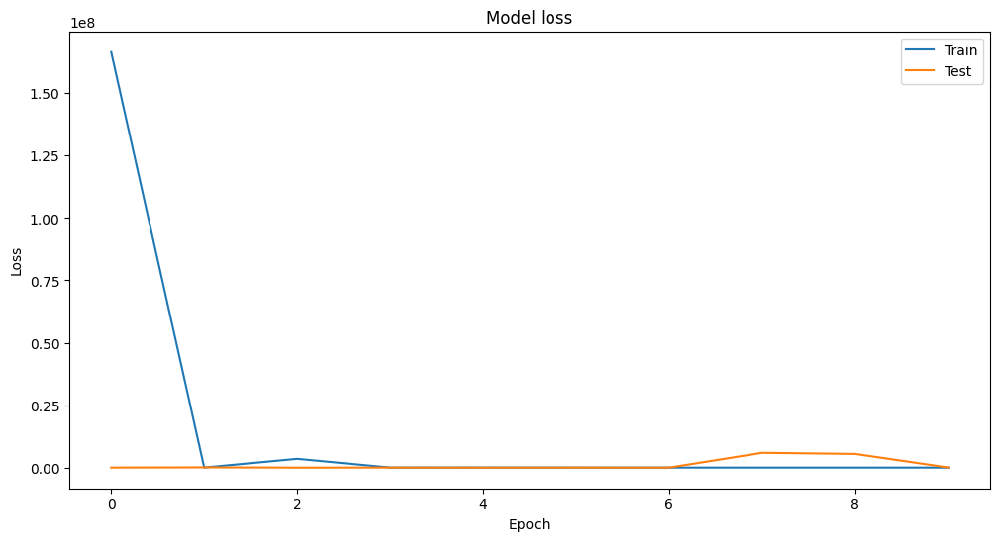

In [6]:
import numpy as np
import pandas as pd
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import ConvLSTM2D, Flatten, Dense
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt

# Define function to create sequences
def create_sequences(X, y, time_steps=10):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X.iloc[i:(i + time_steps)].values)
        ys.append(y.iloc[i + time_steps])
    return np.array(Xs), np.array(ys)

# Remember to drop any NaN values
df_dropna = df.dropna(subset=['ncp'] + feature_columns)

# Create features and target
X = df_dropna[feature_columns]
y = df_dropna['ncp']

# Create sequences
time_steps = 10
X_seq, y_seq = create_sequences(X, y, time_steps)

# Number of samples
n_samples = X_seq.shape[0]

# Train-test split
train_size = int(n_samples * 0.8)
X_train, y_train = X_seq[:train_size], y_seq[:train_size]
X_test, y_test = X_seq[train_size:], y_seq[train_size:]

# Create the ConvLSTM model
model = Sequential()
# model.add(ConvLSTM2D(filters=64, kernel_size=(1,1), activation='relu', input_shape=(time_steps, 1, 1, len(feature_columns))))
model.add(ConvLSTM2D(filters=64, kernel_size=(1,1), activation='relu', input_shape=(time_steps, 1, 1, len(feature_columns))))
model.add(Flatten())
model.add(Dense(1))

# Compile the model
model.compile(optimizer='adam', loss='mse')

# Reshape the data to fit the model
X_train = X_train.reshape((X_train.shape[0], X_train.shape[1], 1, 1, X_train.shape[2]))
X_test = X_test.reshape((X_test.shape[0], X_test.shape[1], 1, 1, X_test.shape[2]))

# Fit the model
history = model.fit(X_train, y_train, epochs=10, validation_data=(X_test, y_test))

# Plot training & validation loss values
plt.figure(figsize=(12, 6))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper right')
plt.show()

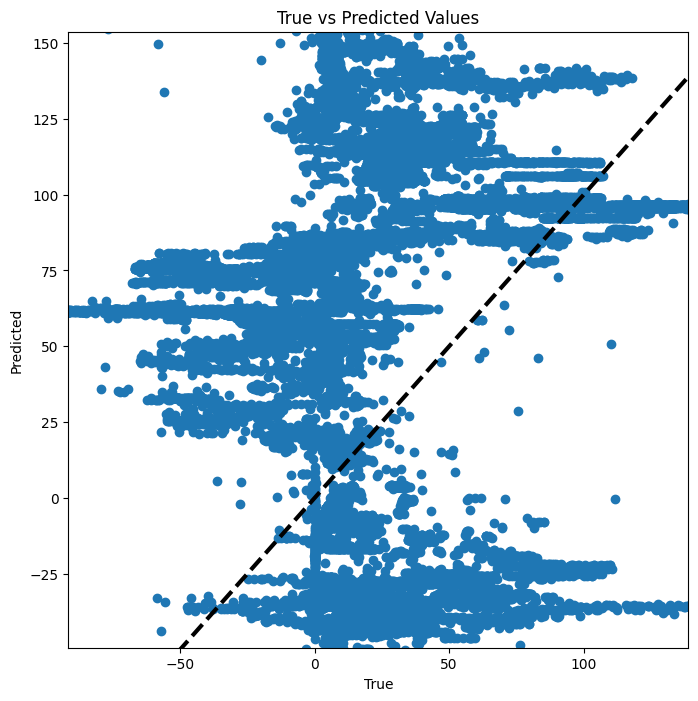

In [11]:
# y_pred = model.predict(X_test)

# # Plot true vs predicted values
# plt.figure(figsize=(10,6))
# plt.scatter(y_test, y_pred, alpha=0.5)
# plt.xlabel('True Values')
# plt.ylabel('Predicted Values')
# plt.title('True vs Predicted Values')
# plt.grid(True)
# plt.show()

import numpy as np
# Calculate the limits for the x-axis and y-axis
x_limit = np.percentile(y_test, [0.5, 99.5])
y_limit = np.percentile(y_pred, [0.5, 99.5])

plt.figure(figsize=(8, 8))
plt.scatter(y_test, y_pred)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=3)
plt.xlabel('True')
plt.ylabel('Predicted')
plt.title('True vs Predicted Values')

# Set the limits for the x-axis and y-axis
plt.xlim(x_limit[0], x_limit[1])
plt.ylim(y_limit[0], y_limit[1])

plt.show()

In [7]:
import pandas as pd
from sklearn.model_selection import train_test_split

# get a list of unique cruise IDs
cruise_ids = df['crsID'].unique()

# split the cruise IDs into train and test sets
train_ids, test_ids = train_test_split(cruise_ids, test_size=0.2, random_state=42)

# create the train and test datasets based on the cruise IDs
train_data = df[df['crsID'].isin(train_ids)]
test_data = df[df['crsID'].isin(test_ids)]


In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.metrics import r2_score
from sklearn.preprocessing import StandardScaler

# Define target and features
target = 'ncp'

# Remove outliers
mean = train_data[target].mean()
std_dev = train_data[target].std()
train_data = train_data[(train_data[target] > mean - 10*std_dev) & (train_data[target] < mean + 10*std_dev)]
test_data = test_data[(test_data[target] > mean - 10*std_dev) & (test_data[target] < mean + 10*std_dev)]

# Prepare the features and target
X_train = train_data.drop(target, axis=1)
y_train = train_data[target]
X_test = test_data.drop(target, axis=1)
y_test = test_data[target]

# Standardize the features
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

# Define the models
models = {
    "Linear Regression": LinearRegression(),
    "Decision Tree": DecisionTreeRegressor(),
    "Random Forest": RandomForestRegressor(),
    "Gradient Boosting": GradientBoostingRegressor(),
}

# Train and evaluate each model
for name, model in models.items():
    model.fit(X_train, y_train)
    predictions = model.predict(X_test)
    score = r2_score(y_test, predictions)
    print(f"{name} R^2 Score: {score}")


Linear Regression R^2 Score: -12.32424088326057
Decision Tree R^2 Score: -1.6882434940562874
Random Forest R^2 Score: -0.7632404418301286
